# Prototyping Render

Starting with output from rectangular solve.

In [1]:
from os.path import abspath
from sys import path
path.insert(0, abspath("../.."))  # Repository directory relative to this file.
from MISalign.model.mis_file import load_mis
from canvas_solve import rectangular_solve
mf=load_mis(r"..\..\example\data\set_a\mymis.mis")
relations=mf.get_rels('r')
image_names=mf.get_image_names()
origin="a_myimages01.jpg"
rs=rectangular_solve(
    relations=relations,
    image_names=image_names,
    origin=origin
)
display(rs)

{'a_myimages01.jpg': (0, 0),
 'a_myimages02.jpg': (12, -1088),
 'a_myimages03.jpg': (20, -2229),
 'a_myimages04.jpg': (-109, -3287),
 'a_myimages05.jpg': (-98, -4230),
 'a_myimages06.jpg': (-93, -5090),
 'a_myimages07.jpg': (-83, -6080),
 'a_myimages08.jpg': (-74, -7089),
 'a_myimages09.jpg': (-65, -8028),
 'a_myimages10.jpg': (-62, -8750)}

## Finding Extents

### Finding image sizes

In [2]:
from PIL import Image as PILImage

In [17]:
# Need image size.
# for name_path in zip(mf.get_image_names(),mf.image_fps):
#     print(name_path)
#     img=PILImage.open(name_path[1])
#     print(img.size)

In [22]:
image_name_paths={name:fp for name,fp in zip(mf.get_image_names(),mf.image_fps)}
image_name_paths

{'a_myimages01.jpg': 'c:\\Users\\drago\\Documents\\MISaligned\\MISalign_public\\example\\data\\set_a\\a_myimages01.jpg',
 'a_myimages02.jpg': 'c:\\Users\\drago\\Documents\\MISaligned\\MISalign_public\\example\\data\\set_a\\a_myimages02.jpg',
 'a_myimages03.jpg': 'c:\\Users\\drago\\Documents\\MISaligned\\MISalign_public\\example\\data\\set_a\\a_myimages03.jpg',
 'a_myimages04.jpg': 'c:\\Users\\drago\\Documents\\MISaligned\\MISalign_public\\example\\data\\set_a\\a_myimages04.jpg',
 'a_myimages05.jpg': 'c:\\Users\\drago\\Documents\\MISaligned\\MISalign_public\\example\\data\\set_a\\a_myimages05.jpg',
 'a_myimages06.jpg': 'c:\\Users\\drago\\Documents\\MISaligned\\MISalign_public\\example\\data\\set_a\\a_myimages06.jpg',
 'a_myimages07.jpg': 'c:\\Users\\drago\\Documents\\MISaligned\\MISalign_public\\example\\data\\set_a\\a_myimages07.jpg',
 'a_myimages08.jpg': 'c:\\Users\\drago\\Documents\\MISaligned\\MISalign_public\\example\\data\\set_a\\a_myimages08.jpg',
 'a_myimages09.jpg': 'c:\\Users\

In [21]:
image_sizes={name:PILImage.open(file_path).size for name,file_path in image_name_paths.items()}
image_sizes

{'a_myimages01.jpg': (1600, 1200),
 'a_myimages02.jpg': (1600, 1200),
 'a_myimages03.jpg': (1600, 1200),
 'a_myimages04.jpg': (1600, 1200),
 'a_myimages05.jpg': (1600, 1200),
 'a_myimages06.jpg': (1600, 1200),
 'a_myimages07.jpg': (1600, 1200),
 'a_myimages08.jpg': (1600, 1200),
 'a_myimages09.jpg': (1600, 1200),
 'a_myimages10.jpg': (1600, 1200)}

### Putting all points together

In [4]:
x=[]
y=[]
for img in image_names:
    img_corner=rs[img] #top left corner
    img_size=image_sizes[img]
    x.append(img_corner[0])#left side
    x.append(img_corner[0]+img_size[0])#right side
    y.append(img_corner[1])#top side
    y.append(img_corner[1]-img_size[1])#bottom side
    # Top to bottom is in the negative direction which is why the -img_size[1] is needed.
minx=min(x)
maxx=max(x)
miny=min(y)
maxy=max(y)
print((minx,maxx),(miny,maxy))

(-109, 1620) (-9950, 0)


### Offsets and canvas extents

In [5]:
canvas_width=maxx-minx
canvas_height=maxy-miny
print("Canvas Extents:",(canvas_width,canvas_height))
offset_x=0-minx
offset_y=0-miny
print("Offsets:",(offset_x,offset_y))

Canvas Extents: (1729, 9950)
Offsets: (109, 9950)


## Canvas Placement

In [7]:
canvas_placement={name:(rs[name][0]+offset_x,rs[name][1]+offset_y) for name in image_names}
canvas_placement

{'a_myimages01.jpg': (109, 9950),
 'a_myimages02.jpg': (121, 8862),
 'a_myimages03.jpg': (129, 7721),
 'a_myimages04.jpg': (0, 6663),
 'a_myimages05.jpg': (11, 5720),
 'a_myimages06.jpg': (16, 4860),
 'a_myimages07.jpg': (26, 3870),
 'a_myimages08.jpg': (35, 2861),
 'a_myimages09.jpg': (44, 1922),
 'a_myimages10.jpg': (47, 1200)}

# Render

## Unblended Render

In [8]:
import numpy as np

In [48]:
# canvas_placement
# image_sizes
# canvas_width
# canvas_height
print((canvas_height,canvas_width))
canvas=np.zeros((canvas_height,canvas_width,3))
for img in image_names:
    print(img)
    img_size=image_sizes[img]
    img_place=canvas_placement[img]
    img_fp=image_name_paths[img]
    # print(img_fp)
    img_arr=np.array(PILImage.open(img_fp))
    # print([canvas_height-img_place[1],canvas_height-(img_place[1]-img_size[1]),img_place[0],img_place[0]+img_size[0]])
    canvas[canvas_height-img_place[1]:canvas_height-(img_place[1]-img_size[1]),img_place[0]:img_place[0]+img_size[0]]=img_arr
    # print(canvas[img_place[1]-img_size[1]:img_place[1],img_place[0]:img_place[0]+img_size[0]].shape)
# PILImage.fromarray(canvas.astype(np.uint8))

(9950, 1729)
a_myimages01.jpg
a_myimages02.jpg
a_myimages03.jpg
a_myimages04.jpg
a_myimages05.jpg
a_myimages06.jpg
a_myimages07.jpg
a_myimages08.jpg
a_myimages09.jpg
a_myimages10.jpg


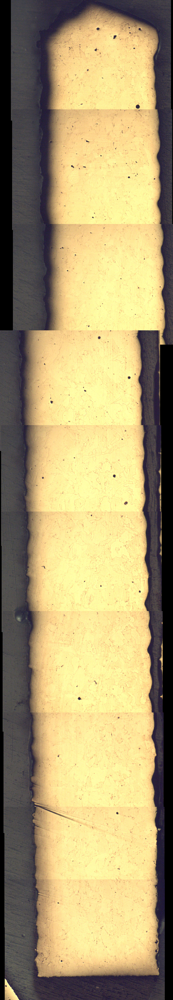

In [49]:
PILImage.fromarray(canvas.astype(np.uint8))
#TODO figure out why position is so broken.